In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
import networkx as nx
from networkx.algorithms import bipartite
from tqdm.notebook import tqdm

In [3]:
df = pd.read_csv('../data/rappler-business-with-ner-timestep-sentiment-score.csv')
df.head()

,Unnamed: 0,date,id,link,categories,authorship,tags,unique_entities,author.name,time_step,sentiment_score
0,0,2022-01-01 12:59:53,1542619,https://www.rappler.com/business/bohol-starts-...,"[621, 624, 701]",[2573],"[1263, 2814, 2290]","['Typhoon Odette', 'Arthur Yap']",NaN,0,0.055859
1,1,2022-01-01 19:54:55,1543036,https://www.rappler.com/business/turkey-lira-c...,"[621, 622]",[5083],"[2625, 1870, 1235]","['Marek Drimal', 'Nureddin Nebati', 'Tayyip Er...",NaN,0,0.007710
2,2,2022-01-01 20:29:57,1543064,https://www.rappler.com/business/indonesia-ban...,"[621, 622, 624]",[5083],"[2716, 1141, 2290]","['Ridwan Jamaludin', 'Perusahaan Listrik Negar...",NaN,0,-0.014912
3,3,2022-01-02 11:34:10,1543150,https://www.rappler.com/business/department-tr...,"[621, 628, 622]",[4270],"[3029, 2802]","['Ramon Lopez', 'Rodrigo Duterte', 'Typhoon Od...",Michelle Abad,0,-0.025336
4,4,2022-01-03 21:00:57,1544290,https://www.rappler.com/business/indonesia-min...,"[621, 624]",[5083],"[2716, 1141, 2648]","['Perusahaan Listrik Negara', 'Puneet Gupta', ...",NaN,0,0.004880


In [3]:
entities = []
for e in df['unique_entities']:
    entities += eval(e)
print('There are', df['id'].nunique(), 'unique news articles.')
print('There are', len(entities), 'mentions of unique entities.')
print('There are', len(np.unique(entities)), 'unique entities.')

There are 2871 unique news articles.
There are 12742 mentions of unique entities.
There are 6858 unique entities.


## Entities linked by Existence in Articles

In [4]:
df['unique_entities']

0                        ['Typhoon Odette', 'Arthur Yap']
1       ['Marek Drimal', 'Nureddin Nebati', 'Tayyip Er...
2       ['Ridwan Jamaludin', 'Perusahaan Listrik Negar...
3       ['Ramon Lopez', 'Rodrigo Duterte', 'Typhoon Od...
4       ['Perusahaan Listrik Negara', 'Puneet Gupta', ...
                              ...                        
2866    ['Josephine Gotianun Yap', 'Jaime Bautista', '...
2867       ['Ronald Jason J Ramos', 'The Zobel de Ayala']
2868    ['Dennis Uy', 'Enrique Razon', 'Dennis Uy', 'R...
2869    ['Tayyip Erdogan', 'Daleep Singh', 'Colin Grah...
2870                ['Edgar Galvante', 'Rodrigo Duterte']
Name: unique_entities, Length: 2871, dtype: object

In [5]:
# Create an empty graph
B = nx.Graph()

# Add nodes with the node attribute "bipartite"
B.add_nodes_from(df['id'], article=1)  # Add article nodes
# All entities from the 'unique_entities' column
all_entities = [entity for sublist in df['unique_entities'] for entity in eval(sublist)]
B.add_nodes_from(set(all_entities), article=0)  # Add entity nodes

# Add edges between articles and entities
for index, row in tqdm(df.iterrows()):
    article_id = row['id']
    entities = eval(row['unique_entities'])
    for entity in entities:
        B.add_edge(article_id, entity)

0it [00:00, ?it/s]

In [19]:
all_entities

['Typhoon Odette',
 'Arthur Yap',
 'Marek Drimal',
 'Nureddin Nebati',
 'Tayyip Erdogan',
 'Ridwan Jamaludin',
 'Perusahaan Listrik Negara',
 'Ahmad Zuhdi Dwi Kusuma',
 'Putera Satria',
 'Ramon Lopez',
 'Rodrigo Duterte',
 'Typhoon Odette',
 'Perusahaan Listrik Negara',
 'Puneet Gupta',
 'Sri Mulyani Indrawati',
 'Matt Warder',
 'Riya Vyas',
 'Pandu Sjahrir',
 'Joko Widodo',
 'Perusahaan Listrik Negara',
 'Sabrin Chowdhury',
 'Pandu Sjahrir',
 'Rory Simington',
 'Joko Widodo',
 'Rodrigo Duterte',
 'Benjamin Diokno',
 'Karl Chua',
 'Dennis Mapa',
 'Jim Cain',
 'Mary Barra',
 'Randy Parker',
 'Jack Hollis',
 'Kristalina Georgieva',
 'Gerry Rice',
 'Joe Biden',
 'Perusahaan Listrik Negara',
 'Erick Thohir',
 'Muhammad Lutfi',
 'Bukit Asam',
 'Joko Widodo',
 'Eric Huang',
 'Tseng Hou jen',
 'Greg Anderson',
 'Colin Scarola',
 'Raymond James',
 'Sheila Kahyaoglu',
 'Peter Singer',
 'Frank Wagemans',
 'Roger Whiteside',
 'Simon Wolfson',
 'Christopher Whalen',
 'Nancy Davis',
 'Karl Chua',
 

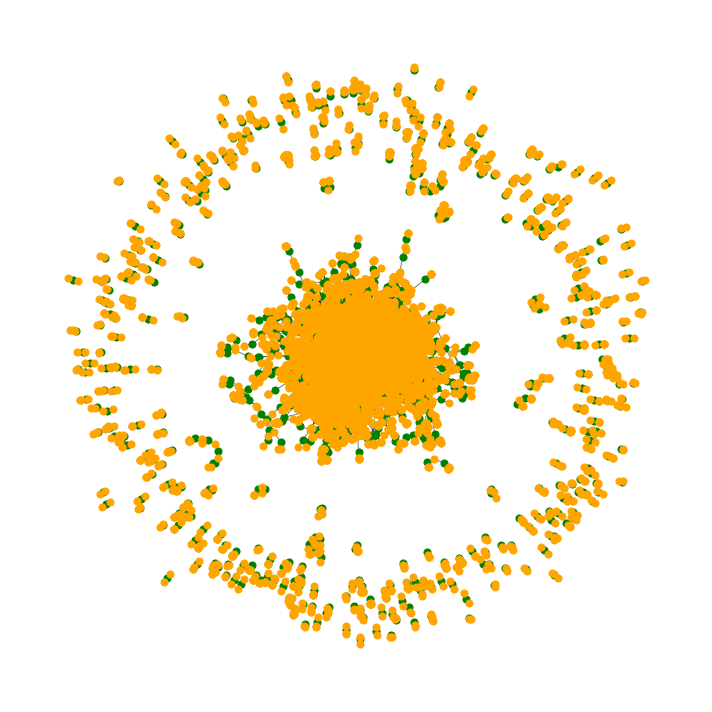

In [6]:
# Determine the nodes for each partition based on the 'bipartite' attribute
article_nodes = [n for n, d in B.nodes(data=True) if d['article']==1]
entity_nodes = [n for n, d in B.nodes(data=True) if d['article']==0]

# Create the bipartite layout
pos = nx.spring_layout(B, seed=34)

# Draw the graph
plt.figure(figsize=(10,10))

# Nodes
nx.draw_networkx_nodes(B, pos, nodelist=article_nodes, node_color='green', node_size=50)
nx.draw_networkx_nodes(B, pos, nodelist=entity_nodes, node_color='orange', node_size=50)

# Edges
nx.draw_networkx_edges(B, pos, width=1, alpha=0.5)  # added alpha for transparency

# If you want to show labels, uncomment the following line. Given the bipartite nature, it might clutter the visualization.
# nx.draw_networkx_labels(B, pos, font_size=12, font_family='sans-serif')

plt.axis('off')
plt.tight_layout()
plt.savefig('bipartite_graph.png', dpi=100)
plt.show()


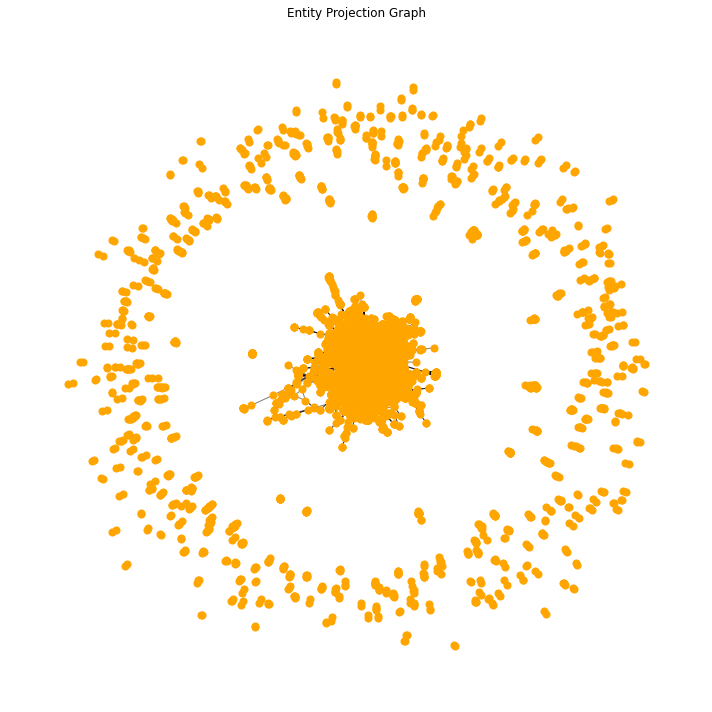

In [7]:
# 1. Create the entity projection
# Project the bipartite graph onto the entities nodes
entity_projection = nx.bipartite.projected_graph(B, entity_nodes)

# 2. Visualize the entity projection graph
# Use the spring layout for positioning
pos = nx.spring_layout(entity_projection, seed=34)

plt.figure(figsize=(10,10))

# Draw nodes and edges
nx.draw_networkx_nodes(entity_projection, pos, node_color='orange', node_size=50)
nx.draw_networkx_edges(entity_projection, pos, alpha=0.5)

# Labels can be added if desired, but with many nodes, it might be cluttered.
# If you want to show labels for specific important nodes or all nodes, you can uncomment the following line.
# nx.draw_networkx_labels(entity_projection, pos, font_size=10, font_family='sans-serif')

plt.title("Entity Projection Graph")
plt.axis('off')
plt.tight_layout()
plt.savefig('entity_projection_graph.png', dpi=100)
plt.show()


In [8]:
# Sort nodes by degree in descending order
sorted_degree = sorted(dict(entity_projection.degree()).items(), key=lambda item: item[1], reverse=True)

# Get the top 10 nodes and their degrees
top_10_degree = sorted_degree[:10]

# Convert to a pandas DataFrame
df_top_10 = pd.DataFrame(top_10_degree, columns=['Node', 'Degree'])

df_top_10

,Node,Degree
0,Joe Biden,582
1,Ferdinand Marcos Jr,529
2,Vladimir Putin,474
3,Rodrigo Duterte,311
4,Jerome Powell,302
5,Janet Yellen,251
6,Liz Truss,206
7,Xi Jinping,194
8,Donald Trump,171
9,Benjamin Diokno,168


In [9]:
# 2. Clustering Coefficient
clustering_coefficient = nx.clustering(entity_projection)
print(f"Average Clustering Coefficient: {nx.average_clustering(entity_projection)}")

# not interesting since all entities appearing in a single article will surely have 1

Average Clustering Coefficient: 0.8138172784173052


In [10]:
# Sort nodes by degree centrality in descending order
sorted_degree_centrality = sorted(nx.degree_centrality(entity_projection).items(), key=lambda item: item[1], reverse=True)

# Get the top 10 nodes and their degree centralities
top_10_degree_centrality = sorted_degree_centrality[:10]

# Convert to a pandas DataFrame
df_top_10_degree_centrality = pd.DataFrame(top_10_degree_centrality, columns=['Node', 'Degree Centrality'])

df_top_10_degree_centrality

,Node,Degree Centrality
0,Joe Biden,0.084877
1,Ferdinand Marcos Jr,0.077147
2,Vladimir Putin,0.069126
3,Rodrigo Duterte,0.045355
4,Jerome Powell,0.044043
5,Janet Yellen,0.036605
6,Liz Truss,0.030042
7,Xi Jinping,0.028292
8,Donald Trump,0.024938
9,Benjamin Diokno,0.024501


In [11]:
# Sort nodes by closeness centrality in descending order
sorted_closeness_centrality = sorted(
    nx.closeness_centrality(entity_projection).items(),
    key=lambda item: item[1],
    reverse=True
)

# Get the top 10 nodes and their closeness centralities
top_10_closeness_centrality = sorted_closeness_centrality[:10]

# Convert to a pandas DataFrame
df_top_10_closeness = pd.DataFrame(top_10_closeness_centrality, columns=['Node', 'Closeness Centrality'])

df_top_10_closeness

,Node,Closeness Centrality
0,Joe Biden,0.331680
1,Vladimir Putin,0.296103
2,Donald Trump,0.294322
3,Xi Jinping,0.291003
4,Janet Yellen,0.285571
5,Kristalina Georgieva,0.279463
6,Jerome Powell,0.278704
7,Ferdinand Marcos Jr,0.276815
8,Rishi Sunak,0.275654
9,Ursula von der Leyen,0.273379


In [24]:
# Sort nodes by betweenness centrality in descending order
sorted_betweenness_centrality = sorted(
    nx.betweenness_centrality(entity_projection).items(),
    key=lambda item: item[1],
    reverse=True)

# Get the top 10 nodes and their betweenness centralities
top_10_betweenness_centrality = sorted_betweenness_centrality[:10]

# Convert to a pandas DataFrame
df_top_10_betweenness = pd.DataFrame(top_10_betweenness_centrality, columns=['Node', 'Betweenness Centrality'])

df_top_10_betweenness

,Node,Betweenness Centrality
0,Joe Biden,0.226469
1,Ferdinand Marcos Jr,0.129743
2,Vladimir Putin,0.098049
3,Xi Jinping,0.063792
4,Donald Trump,0.058784
5,Rodrigo Duterte,0.057871
6,Jerome Powell,0.050466
7,Janet Yellen,0.037458
8,Rishi Sunak,0.024459
9,Elon Musk,0.022282


In [25]:
# 6. Density
density = nx.density(entity_projection)
print(f"Density: {density}")

Density: 0.0013365144290608125


## Articles linked by Similar Entities

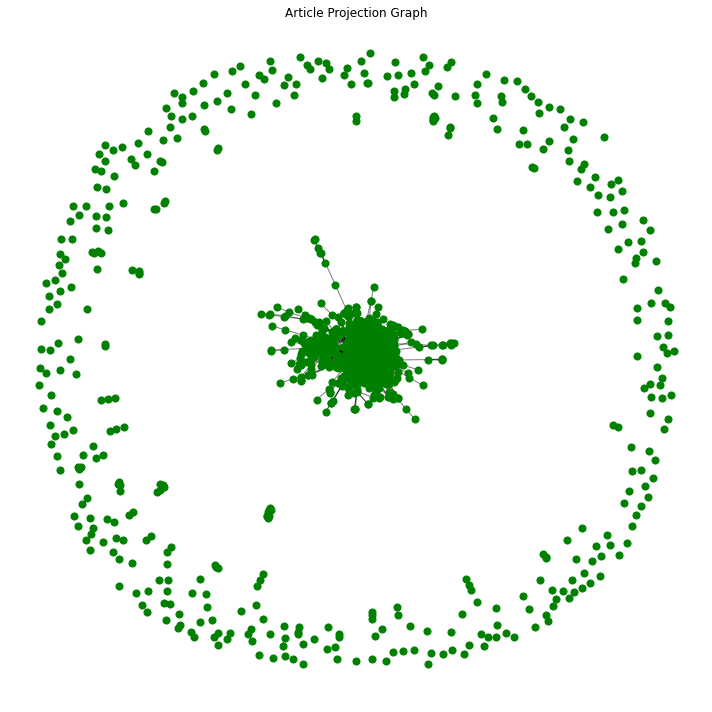

In [7]:
# 1. Create the article projection
# Project the bipartite graph onto the article nodes
article_projection = nx.bipartite.projected_graph(B, article_nodes)

# 2. Visualize the article projection graph
# Use the spring layout for positioning
pos = nx.spring_layout(article_projection, seed=34)

plt.figure(figsize=(10,10))

# Draw nodes and edges
nx.draw_networkx_nodes(article_projection, pos, node_color='green', node_size=50)
nx.draw_networkx_edges(article_projection, pos, alpha=0.5)

# Labels can be added if desired, but with many nodes, it might be cluttered.
# If you want to show labels for specific important nodes or all nodes, you can uncomment the following line.
# nx.draw_networkx_labels(article_projection, pos, font_size=10, font_family='sans-serif')

plt.title("Article Projection Graph")
plt.axis('off')
plt.tight_layout()
plt.savefig('article_projection_graph.png', dpi=100)
plt.show()



In [8]:
df['article_title'] = df['link'].str.split('/').apply(lambda x: x[-2])

In [28]:
# Sort nodes by degree in descending order
sorted_degree = sorted(
    dict(article_projection.degree()).items(),
    key=lambda item: item[1],
    reverse=True
)

# Get the top 10 nodes and their degrees
top_10_degree = sorted_degree[:10]

# Convert to a pandas DataFrame
df_top_10 = pd.DataFrame(top_10_degree,
                         columns=['Node', 'Degree'])

df_top_10['titles'] = df.set_index("id")['article_title'].loc[
    df_top_10.Node
].tolist()

df_top_10

,Node,Degree,titles
0,1750778,594,united-states-federal-reserve-white-house-slow...
1,1563360,545,updates-global-stock-markets-oil-prices-januar...
2,1646105,524,united-states-sanctions-russia-sberbank-putin-...
3,2276457,510,artificial-intelligence-race-canva-draws-line-...
4,1596589,482,momentum-grows-ban-russia-swift-payment-system...
5,1631758,469,china-sinopec-pauses-russia-projects-wary-sanc...
6,1631719,468,united-states-european-union-liquefied-natural...
7,1600144,466,china-boosts-oil-reserves-ignoring-united-stat...
8,2123714,466,russia-says-nord-stream-likely-hit-state-backe...
9,1597716,465,united-states-allies-target-russia-swift-ban-c...


In [17]:
# 2. Clustering Coefficient
clustering_coefficient = nx.clustering(article_projection)
print(f"Average Clustering Coefficient: {nx.average_clustering(article_projection)}")

# not interesting since all entities appearing in a single article will surely have 1

Average Clustering Coefficient: 0.6367534381915688


In [18]:
# Sort nodes by degree centrality in descending order
sorted_degree_centrality = sorted(
    nx.degree_centrality(article_projection).items(),
    key=lambda item: item[1],
    reverse=True
)

# Get the top 10 nodes and their degree centralities
top_10_degree_centrality = sorted_degree_centrality[:10]

# Convert to a pandas DataFrame
df_top_10_degree_centrality = pd.DataFrame(top_10_degree_centrality, columns=['Node', 'Degree Centrality'])

df_top_10_degree_centrality['titles'] = df.set_index("id")['article_title'].loc[
    df_top_10_degree_centrality.Node
].tolist()

df_top_10_degree_centrality

,Node,Degree Centrality,titles
0,1750778,0.206969,united-states-federal-reserve-white-house-slow...
1,1563360,0.189895,updates-global-stock-markets-oil-prices-januar...
2,1646105,0.182578,united-states-sanctions-russia-sberbank-putin-...
3,2276457,0.177700,artificial-intelligence-race-canva-draws-line-...
4,1596589,0.167944,momentum-grows-ban-russia-swift-payment-system...
5,1631758,0.163415,china-sinopec-pauses-russia-projects-wary-sanc...
6,1631719,0.163066,united-states-european-union-liquefied-natural...
7,1600144,0.162369,china-boosts-oil-reserves-ignoring-united-stat...
8,2123714,0.162369,russia-says-nord-stream-likely-hit-state-backe...
9,1597716,0.162021,united-states-allies-target-russia-swift-ban-c...


In [19]:
# Sort nodes by closeness centrality in descending order
sorted_closeness_centrality = sorted(
    nx.closeness_centrality(article_projection).items(),
    key=lambda item: item[1],
    reverse=True
)

# Get the top 10 nodes and their closeness centralities
top_10_closeness_centrality = sorted_closeness_centrality[:10]

# Convert to a pandas DataFrame
df_top_10_closeness = pd.DataFrame(top_10_closeness_centrality, columns=['Node', 'Closeness Centrality'])

df_top_10_closeness['titles'] = df.set_index("id")['article_title'].loc[
    df_top_10_closeness.Node
].tolist()

df_top_10_closeness

,Node,Closeness Centrality,titles
0,2276457,0.405815,artificial-intelligence-race-canva-draws-line-...
1,1750778,0.405179,united-states-federal-reserve-white-house-slow...
2,1563360,0.399002,updates-global-stock-markets-oil-prices-januar...
3,1646105,0.397851,united-states-sanctions-russia-sberbank-putin-...
4,1597716,0.393459,united-states-allies-target-russia-swift-ban-c...
5,1596589,0.393235,momentum-grows-ban-russia-swift-payment-system...
6,1631758,0.392191,china-sinopec-pauses-russia-projects-wary-sanc...
7,1600144,0.391745,china-boosts-oil-reserves-ignoring-united-stat...
8,1861260,0.391522,saudi-arabia-walks-oil-policy-tightrope-betwee...
9,1631719,0.391374,united-states-european-union-liquefied-natural...


In [20]:
# Sort nodes by betweenness centrality in descending order
sorted_betweenness_centrality = sorted(
    nx.betweenness_centrality(article_projection).items(),
    key=lambda item: item[1],
    reverse=True)

# Get the top 10 nodes and their betweenness centralities
top_10_betweenness_centrality = sorted_betweenness_centrality[:10]

# Convert to a pandas DataFrame
df_top_10_betweenness = pd.DataFrame(top_10_betweenness_centrality, columns=['Node', 'Betweenness Centrality'])

df_top_10_betweenness['titles'] = df.set_index("id")['article_title'].loc[
    df_top_10_betweenness.Node
].tolist()

df_top_10_betweenness

,Node,Betweenness Centrality,titles
0,2276457,0.169926,artificial-intelligence-race-canva-draws-line-...
1,2226280,0.017709,air-india-seals-record-order-airbus-boeing-jet...
2,1583387,0.016550,unilever-expects-new-ben-jerrys-arrangement-is...
3,1822661,0.016293,build-build-build-mapping-duterte-administrati...
4,2195285,0.016105,is-it-time-philippines-air-traffic-control-be-...
5,2134804,0.010633,international-monetary-fund-message-britain-of...
6,1647197,0.010304,easy-russia-sanctions-exhausted-united-states-...
7,2202488,0.009954,explainer-davos-2023-world-economic-forum
8,2136703,0.009875,britain-chancellor-exchequer-jeremy-hunt-vows-...
9,2291023,0.008828,united-states-california-regulators-seize-firs...


In [21]:
# 6. Density
density = nx.density(article_projection)
print(f"Density: {density}")

Density: 0.025947568924860765


In [23]:
def rolling_window_analysis(df, p):
    # Convert the 'date' column to datetime if it's not
    df['date'] = pd.to_datetime(df['date'])
    
    start_date = df['date'].min()
    end_date = df['date'].max()
    current_date = start_date
    
    results = {}
    
    while current_date <= end_date:
        # Filter dataframe for the current week
        week_df = df[(df['date'] >= current_date) & (df['date'] < current_date + timedelta(7))]
        
        # Create the bipartite graph
        B = nx.Graph()
        B.add_nodes_from(week_df['id'], bipartite=0)
        entities = [entity for sublist in week_df['unique_entities'] for entity in eval(sublist)]
        B.add_nodes_from(set(entities), bipartite=1)
        for _, row in week_df.iterrows():
            for entity in eval(row['unique_entities']):
                B.add_edge(row['id'], entity)
        
        # Project the bipartite graph
        entity_nodes = {n for n, d in B.nodes(data=True) if d['bipartite'] == 1}
        entity_projection = nx.bipartite.projected_graph(B, entity_nodes)
        
        # Calculate the degree
        degree_dict = dict(entity_projection.degree())
        for entity, degree in degree_dict.items():
            if entity not in results:
                results[entity] = []
            results[entity].append((current_date, degree))
        
        # Move to the next day
        current_date += timedelta(1)
    
    # Sort entities by their maximum degree achieved in any week
    max_degree_entities = sorted(results, key=lambda x: max([degree for _, degree in results[x]]), reverse=True)
    
    # Consider only the top p entities
    top_p_entities = max_degree_entities[:p]
    
    # Plotting
    plt.figure(figsize=(15, 10))
    for entity in top_p_entities:
        values = results[entity]
        dates, degrees = zip(*values)
        plt.plot(dates, degrees, '-', label=entity)
    
    plt.ylabel("Degree")
    plt.xlabel("Date")
    plt.title(f"Top {p} entities' degree progression over time")
    plt.legend(loc='upper left', bbox_to_anchor=(1,1), ncol=1)
    plt.tight_layout()
    plt.show()

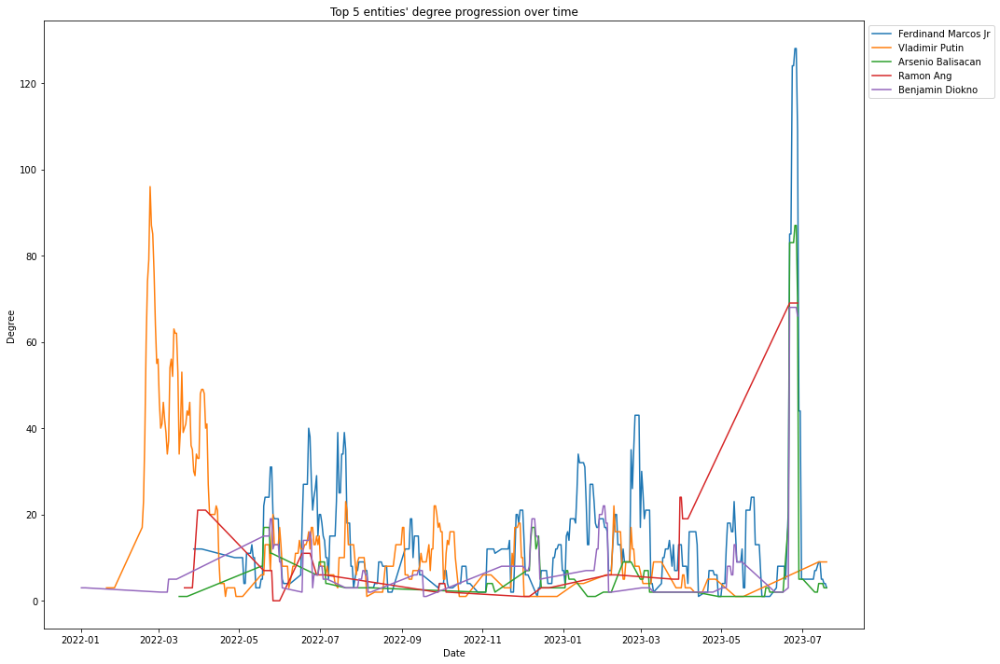

In [24]:
# Usage
rolling_window_analysis(df, 5)

In [15]:
df.date.max()

'2023-07-22 11:20:47'

In [53]:
import pandas as pd
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from gensim import corpora, models
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import NMF

In [19]:
lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words('english'))

def clean_title(title):
    words = title.split('-')
    words = [word for word in words if word not in stop_words]
    words = [word for word in words if not word.isdigit()]
    words = [lemmatizer.lemmatize(word) for word in words]
    return words

df['cleaned_titles'] = df['article_title'].apply(clean_title)

In [59]:
# Create a dictionary and corpus required for LDA
dictionary = corpora.Dictionary(df['cleaned_titles'])
corpus = [dictionary.doc2bow(text) for text in df['cleaned_titles']]

# Apply LDA model
lda_model = models.LdaModel(corpus, num_topics=6, id2word=dictionary, passes=20)  # Assuming 5 topics; adjust as needed

topics = lda_model.print_topics(num_words=10)  # Top 5 words for each topic
for topic in topics:
    print(topic)

(0, '0.033*"report" + 0.027*"earnings" + 0.016*"india" + 0.013*"johnson" + 0.011*"q1" + 0.011*"january" + 0.009*"group" + 0.009*"boeing" + 0.008*"adani" + 0.008*"philippine"')
(1, '0.058*"price" + 0.053*"global" + 0.048*"oil" + 0.048*"market" + 0.045*"stock" + 0.041*"update" + 0.034*"currency" + 0.015*"march" + 0.015*"may" + 0.013*"credit"')
(2, '0.015*"china" + 0.013*"say" + 0.008*"product" + 0.008*"domestic" + 0.008*"gross" + 0.007*"jpmorgan" + 0.007*"energy" + 0.006*"covid" + 0.006*"airline" + 0.006*"company"')
(3, '0.079*"united" + 0.072*"state" + 0.023*"rate" + 0.019*"bank" + 0.017*"inflation" + 0.015*"may" + 0.014*"march" + 0.014*"reserve" + 0.013*"federal" + 0.012*"debt"')
(4, '0.025*"bank" + 0.020*"fund" + 0.018*"monetary" + 0.013*"european" + 0.013*"international" + 0.011*"policy" + 0.010*"debt" + 0.010*"march" + 0.010*"sri" + 0.009*"june"')
(5, '0.036*"russia" + 0.027*"ukraine" + 0.012*"bank" + 0.012*"gas" + 0.011*"oil" + 0.010*"crisis" + 0.010*"say" + 0.009*"cut" + 0.009*"sa

In [56]:
# Combine all titles into a list
titles = df['article_title'].tolist()

# Convert the titles to a matrix of TF-IDF features
tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2, stop_words='english')
tfidf = tfidf_vectorizer.fit_transform(titles)

# Apply NMF model (assuming 5 topics; adjust as needed)
nmf_model = NMF(n_components=15, random_state=1).fit(tfidf)

# Print the top words for each topic
feature_names = tfidf_vectorizer.get_feature_names_out()
for topic_idx, topic in enumerate(nmf_model.components_):
    print(f"Topic #{topic_idx + 1}:")
    print(" ".join([feature_names[i] for i in topic.argsort()[:-10 - 1:-1]]))
    print("\n")

Topic #1:
updates markets stock global prices oil currencies november 14 26


Topic #2:
2022 september october june july august britain gas january april


Topic #3:
report earnings q1 january december 2021 2022 q4 q3 year


Topic #4:
russia ukraine invasion sanctions gas europe war russian union european


Topic #5:
states united debt ceiling biden unemployment joe yellen janet sales


Topic #6:
rate inflation kingdom philippines unemployment united december 2021 argentina february


Topic #7:
reserve federal policy rates monetary powell jerome states united testimony


Topic #8:
domestic product gross q4 q2 q1 2021 2022 philippines japan


Topic #9:
crisis sri lanka economic debt hit fuel energy talks india


Topic #10:
fund monetary international maharlika loan ukraine approves policy bailout wealth


Topic #11:
march credit suisse 2023 ubs switzerland 2022 16 shares deal


Topic #12:
china 19 covid imports exports sales retail hong kong april


Topic #13:
bank central world europea

In [168]:
# Translation
from langdetect import detect_langs, LangDetectException
from googletrans import Translator

import pandas as pd
# from gensim import corpora, models
# from gensim.parsing.preprocessing import STOPWORDS
from nltk.stem import WordNetLemmatizer, SnowballStemmer
from nltk.tokenize import word_tokenize
import nltk

from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import WordPunctTokenizer
from string import punctuation
from sklearn.feature_extraction.text import TfidfVectorizer

# Remove import warnings
import warnings
from numba import NumbaWarning
warnings.filterwarnings("ignore", category=NumbaWarning)

# Topic Modeling
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer
from umap import UMAP
# from cuml.manifold import UMAP # Maximize GPU Utilization
from hdbscan import HDBSCAN
# from cuml.cluster import HDBSCAN # Maximize GPU Utilization
from sklearn.feature_extraction.text import CountVectorizer
# import openai
from bertopic.representation import KeyBERTInspired, MaximalMarginalRelevance
from bertopic.representation import OpenAI, PartOfSpeech
from collections import defaultdict
from sklearn.cluster import KMeans
import matplotlib.colors as mcolors

In [58]:
# Pre-calculate embeddings
embedding_model = SentenceTransformer("all-mpnet-base-v2")
umap_model = UMAP(n_neighbors=20,
                  n_components=5,
                  min_dist=0.0,
                  metric='cosine',
                  random_state=42)
hdbscan_model = HDBSCAN(min_cluster_size=50,
                        metric='euclidean',
                        cluster_selection_method='eom',
                        prediction_data=True)
vectorizer_model = CountVectorizer(stop_words="english",
                                   min_df=2,
                                   ngram_range=(1, 2))
# KeyBERT
keybert_model = KeyBERTInspired()

# Part-of-Speech
pos_model = PartOfSpeech("en_core_web_lg")

# MMR
mmr_model = MaximalMarginalRelevance(diversity=0.3)

# All representation models
representation_model = {
    "KeyBERT": keybert_model,
    "MMR": mmr_model,
    "POS": pos_model
}

In [59]:
docs2 = df.cleaned_titles.apply(lambda x: ' '.join(x)).tolist()
embeddings = embedding_model.encode(docs2, show_progress_bar=True)

Batches:   0%|          | 0/90 [00:00<?, ?it/s]

In [60]:
topic_model5 = BERTopic(

    # Pipeline models
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer_model,
    representation_model=representation_model,
    top_n_words=10,
    verbose=True
)

topics5, probs = topic_model5.fit_transform(docs2, embeddings)

2023-08-30 08:10:38,812 - BERTopic - Reduced dimensionality
2023-08-30 08:10:38,906 - BERTopic - Clustered reduced embeddings


In [61]:
topic_model5.get_topic_info()['Name'].tolist()

['-1_update_stock_market_price',
 '0_russia_ukraine_russian_gas',
 '1_inflation_united_state_united state',
 '2_philippine_marcos_jr_marcos jr',
 '3_china_covid_chinese_hong kong',
 '4_earnings_earnings report_report_q1',
 '5_airline_boeing_air_airbus',
 '6_currency_currency oil_market currency_update global',
 '7_sri_sri lanka_lanka_crisis',
 '8_credit suisse_suisse_credit_switzerland']

In [62]:
topic_model5.get_topic_info()

,Topic,Count,Name,Representation,KeyBERT,MMR,POS,Representative_Docs
0,-1,842,-1_update_stock_market_price,"[update, stock, market, price, update global, ...","[oil price, market oil, global stock, currency...","[update, stock, market, price, update global, ...","[stock, market, price, global, global stock, o...",[update global stock market currency oil price...
1,0,716,0_russia_ukraine_russian_gas,"[russia, ukraine, russian, gas, energy, sancti...","[ukraine war, ukraine, putin, russia, russian ...","[russia, ukraine, russian, gas, energy, sancti...","[russian, gas, energy, sanction, oil, invasion...",[russia aircraft lease axed european union san...
2,1,476,1_inflation_united_state_united state,"[inflation, united, state, united state, rate,...","[monetary policy, federal reserve, rate hike, ...","[inflation, united, state, united state, rate,...","[inflation, rate, monetary, policy, monetary p...","[inflation rate united state may, united state..."
3,2,300,2_philippine_marcos_jr_marcos jr,"[philippine, marcos, jr, marcos jr, airport, m...","[philippine, ferdinand marcos, manila, cebu, m...","[philippine, marcos, jr, marcos jr, airport, m...","[philippine, traffic, business, tax, city, eco...",[philippine economy poised growth marcos jr te...
4,3,168,3_china_covid_chinese_hong kong,"[china, covid, chinese, hong kong, hong, kong,...","[china economic, june china, march china, impo...","[china, covid, chinese, hong kong, hong, kong,...","[covid, chinese, luxury, import, target, prope...","[china export import june, china export import..."
5,4,107,4_earnings_earnings report_report_q1,"[earnings, earnings report, report, q1, report...","[earnings report, earnings forecast, earnings,...","[earnings, earnings report, report, q1, report...","[earnings, report, q1, year, fiscal, unionbank...","[harley davidson earnings report q4, glaxosmit..."
6,5,88,5_airline_boeing_air_airbus,"[airline, boeing, air, airbus, jet, flight, or...","[airbus boeing, boeing, airbus, airline, airli...","[airline, boeing, air, airbus, jet, flight, or...","[airline, jet, flight, order, travel, pilot, s...",[united airline order boeing dreamliner max de...
7,6,61,6_currency_currency oil_market currency_update...,"[currency, currency oil, market currency, upda...","[oil price, market oil, price september, globa...","[currency, currency oil, market currency, upda...","[currency, global stock, stock, global, market...",[update global stock market currency oil price...
8,7,57,7_sri_sri lanka_lanka_crisis,"[sri, sri lanka, lanka, crisis, economic crisi...","[lanka debt, lanka, economic crisis, sri lanka...","[sri, sri lanka, lanka, crisis, economic crisi...","[crisis, economic crisis, monetary fund, monet...","[timeline sri lanka economic crisis, sri lanka..."
9,8,56,8_credit suisse_suisse_credit_switzerland,"[credit suisse, suisse, credit, switzerland, m...","[credit suisse, suisse, bank international, ba...","[credit suisse, suisse, credit, switzerland, m...","[suisse, credit, takeover, bank, share, rescue...",[credit suisse turnaround got lot tougher mark...


In [148]:
df['topic'] = topics5
df['topic'] = df.topic.map({0:'russian_ukraine_war',1:'inflation',2:'ph_marcos_jr',3:'covid',4:'ph_gdp',5:'airlines',6:'fuel_oil_market',7:'sri_lanka_crisis',8:'credit_suisse'}).fillna('others')

In [88]:
df.topic.unique()

array(['russian_ukraine_war', 'inflation', 'others', 'covid', 'airlines',
       'sri_lanka_crisis', 'ph_marcos_jr', 'fuel_oil_market',
       'credit_suisse', 'ph_gdp'], dtype=object)

In [112]:
# Pre-calculate embeddings
umap_model = UMAP(n_neighbors=10,
                  n_components=5,
                  min_dist=0.0,
                  metric='cosine',
                  random_state=42)
hdbscan_model = HDBSCAN(min_cluster_size=50,
                        metric='euclidean',
                        cluster_selection_method='eom',
                        prediction_data=True)
vectorizer_model = CountVectorizer(stop_words="english",
                                   min_df=2,
                                   ngram_range=(1, 2))
# KeyBERT
keybert_model = KeyBERTInspired()

# Part-of-Speech
pos_model = PartOfSpeech("en_core_web_lg")

# MMR
mmr_model = MaximalMarginalRelevance(diversity=0.3)

# All representation models
representation_model = {
    "KeyBERT": keybert_model,
    "MMR": mmr_model,
    "POS": pos_model
}

In [113]:
docs3 = df[df.topic=='others'].cleaned_titles.apply(lambda x: ' '.join(x)).tolist()
embeddings = embedding_model.encode(docs3, show_progress_bar=True)

topic_model5 = BERTopic(

    # Pipeline models
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer_model,
    representation_model=representation_model,
    top_n_words=10,
    verbose=True
)

topics6, probs = topic_model5.fit_transform(docs3, embeddings)

Batches:   0%|          | 0/27 [00:00<?, ?it/s]

2023-08-30 08:26:29,896 - BERTopic - Reduced dimensionality
2023-08-30 08:26:29,953 - BERTopic - Clustered reduced embeddings


In [114]:
topic_model5.get_topic_info()['Name'].tolist()

['-1_stock_update_global_stock market',
 '0_worker_united_south_cost',
 '1_gross domestic_domestic_gross_domestic product']

In [115]:
topic_model5.get_topic_info()

,Topic,Count,Name,Representation,KeyBERT,MMR,POS,Representative_Docs
0,-1,479,-1_stock_update_global_stock market,"[stock, update, global, stock market, price, m...","[oil price, stock market, update, price februa...","[stock, update, global, stock market, price, m...","[stock, global, price, market, oil, currency, ...",[update global stock market currency oil price...
1,0,277,0_worker_united_south_cost,"[worker, united, south, cost, kingdom, united ...","[unemployment rate, united kingdom, labor, wor...","[worker, united, south, cost, kingdom, united ...","[worker, cost, crisis, budget, tax, oil, short...","[united kingdom foreign worker june, post brex..."
2,1,86,1_gross domestic_domestic_gross_domestic product,"[gross domestic, domestic, gross, domestic pro...","[domestic product, gross domestic, economic gr...","[gross domestic, domestic, gross, domestic pro...","[domestic product, domestic, gross, product, i...","[gross domestic product united state q1, gross..."


In [151]:
df2 = df[df.topic=='others']
df2['topic'] = topics6
df2['topic'] = df2.topic.map({-1:'global_market',0:'uk_bugdet_unemployment',1:'ph_gdp'})

In [164]:
df_final = pd.concat([df[df.topic!='others'], df2]).sort_index()
df_final['month'] = pd.to_datetime(df_final.date).dt.strftime('%Y-%m')

In [165]:
df_final.to_csv('articles_w_topics.csv', index=False)

In [8]:
df_final = pd.read_csv('articles_w_topics.csv')

In [9]:
# 1. Create the article projection
# Project the bipartite graph onto the article nodes
m_df = df_final[df_final.month == '2022-01']
article_nodes = m_df.id.unique().tolist()
labels = pd.Series(df_final.topic.values,index=df_final.id).to_dict()


unique_labels = list(set(labels.values()))
cmap = mcolors.ListedColormap(list(mcolors.CSS4_COLORS.values())[:len(unique_labels)], name='allcolors')
label_to_color = {label: cmap.colors[idx] for idx, label in enumerate(unique_labels)}

article_projection = nx.bipartite.projected_graph(B, article_nodes)
node_colors = [label_to_color[labels[node]] for node in article_projection.nodes()]

# 2. Visualize the article projection graph

# Use the spring layout for positioning
pos = nx.spring_layout(article_projection, seed=34)

plt.figure(figsize=(10,10))

# Draw nodes and edges
nx.draw_networkx_nodes(article_projection, pos, node_color=node_colors, cmap=cmap, node_size=50)
nx.draw_networkx_edges(article_projection, pos, alpha=0.5)

# Labels can be added if desired, but with many nodes, it might be cluttered.
# If you want to show labels for specific important nodes or all nodes, you can uncomment the following line.
# nx.draw_networkx_labels(article_projection, pos, font_size=10, font_family='sans-serif')

plt.title("Article Projection Graph")
plt.axis('off')
plt.tight_layout()
plt.show()

NameError: name 'mcolors' is not defined

In [10]:
article_nodes = [n for n, d in B.nodes(data=True) if d['article']==1]

In [11]:
def custom_layout(G, labels):
    # Get unique labels and the number of nodes for each label
    unique_labels = list(set(labels.values()))
    
    # Define grid positions for cluster centers
    grid_positions = [(i, j) for i in range(3) for j in range(4)]
    if len(unique_labels) < len(grid_positions):
        grid_positions = grid_positions[:len(unique_labels)]
    
    cluster_centers = {label: pos for label, pos in zip(unique_labels, grid_positions)}

    pos = {}
    for label in unique_labels:
        # Nodes in the current cluster
        cluster_nodes = [node for node, cluster_label in labels.items() if cluster_label == label]
        
        # Use spring layout for nodes within the cluster
        cluster_pos = nx.random_layout(G.subgraph(cluster_nodes))
        
        # Translate the spring layout positions to the cluster's position
        for node, (x, y) in cluster_pos.items():
            pos[node] = (x + cluster_centers[label][0], y + cluster_centers[label][1])

    return pos

def plot_network(m):
    m_df = df_final[df_final.month == m]
    #article_nodes = m_df.id.unique().tolist()
    labels = pd.Series(df_final.topic.values,index=df_final.id).to_dict()

    topic_counts = m_df.topic.value_counts().to_dict()

    # Create a sample graph (replace this with your graph)
    article_projection = nx.bipartite.projected_graph(B, article_nodes)
    article_projection.remove_nodes_from(df_final[df_final.month != m].id.tolist())
    article_projection.remove_nodes_from(list(nx.isolates(article_projection)))

    pos = custom_layout(article_projection, labels)

    # Set node colors based on external cluster labels
    unique_labels = list(set(labels.values()))
    color_map = {label: plt.cm.jet(i/len(unique_labels)) for i, label in enumerate(unique_labels)}
    node_colors = [(*color_map[labels[node]][:3], 0.6) for node in article_projection.nodes()]

    plt.figure(figsize=(10, 10))
    nx.draw(article_projection, pos, node_color=node_colors, edge_color=(0.4823529411764706, 0.48627450980392156, 0.48627450980392156,0.5), node_size=500)
    plt.title("Graph with Custom Layout for 11 Clusters")
    patchList = []
    for label, color in color_map.items():
        try:
            data_key = f"{label} ({topic_counts[label]})"
        except:
            data_key = f"{label} ({0})"
        patchList.append(plt.Line2D([0], [0], marker='o', color='white', markerfacecolor=color, markersize=10, label=data_key))
    plt.legend(handles=patchList, loc='upper right')
    plt.savefig(f'images/{m}.png', dpi=200)

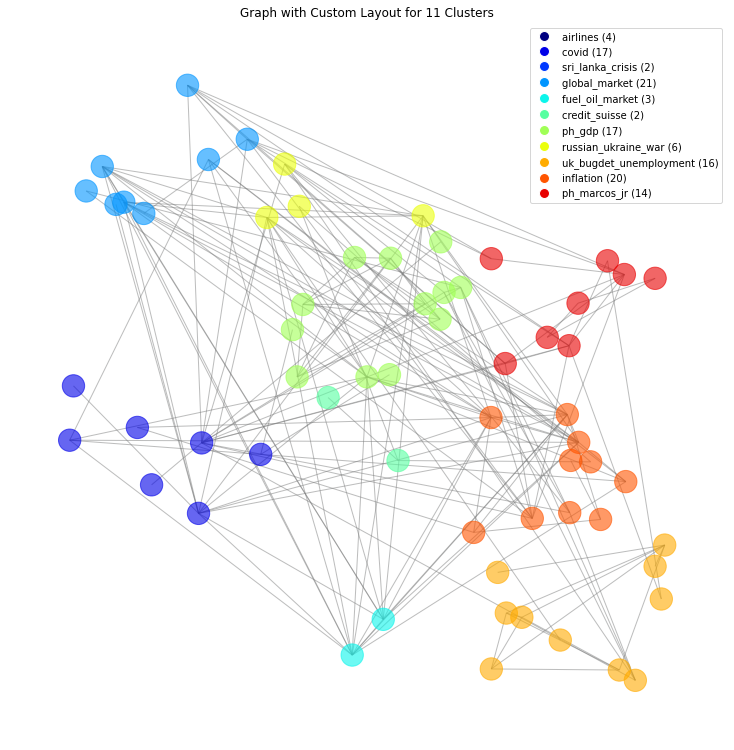

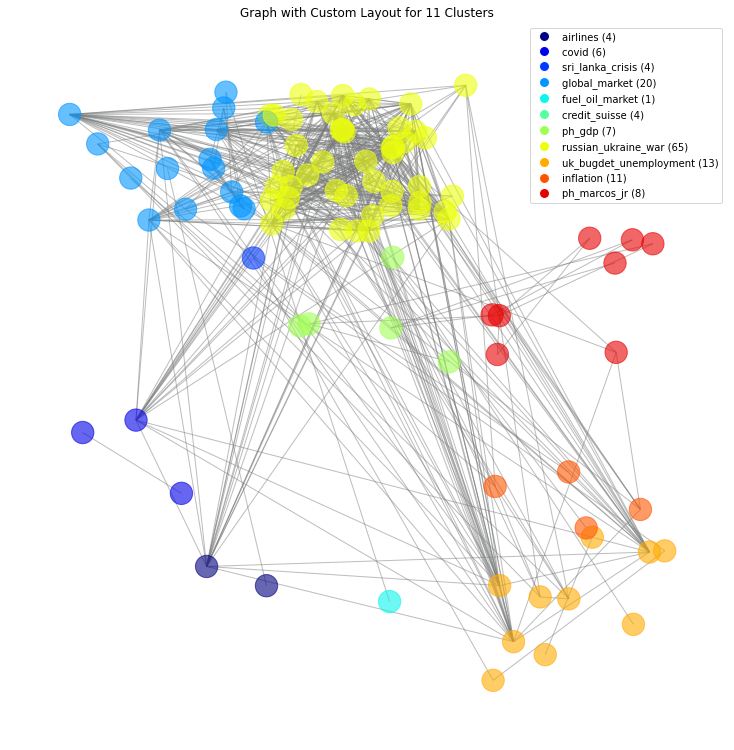

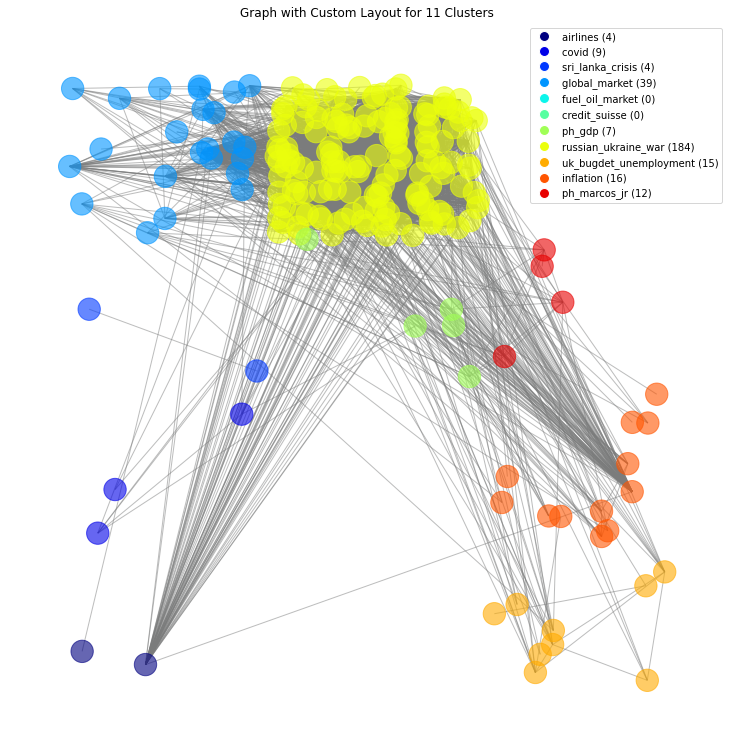

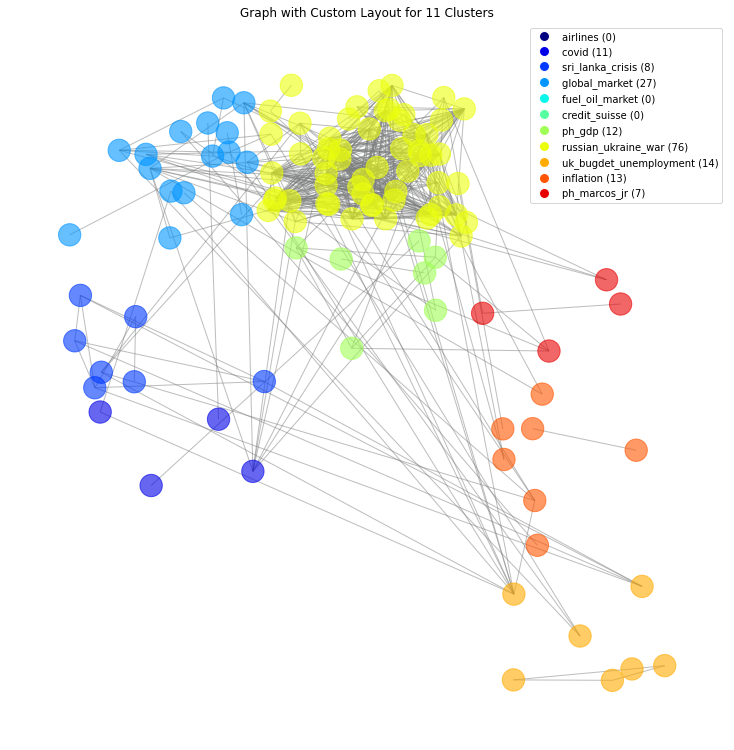

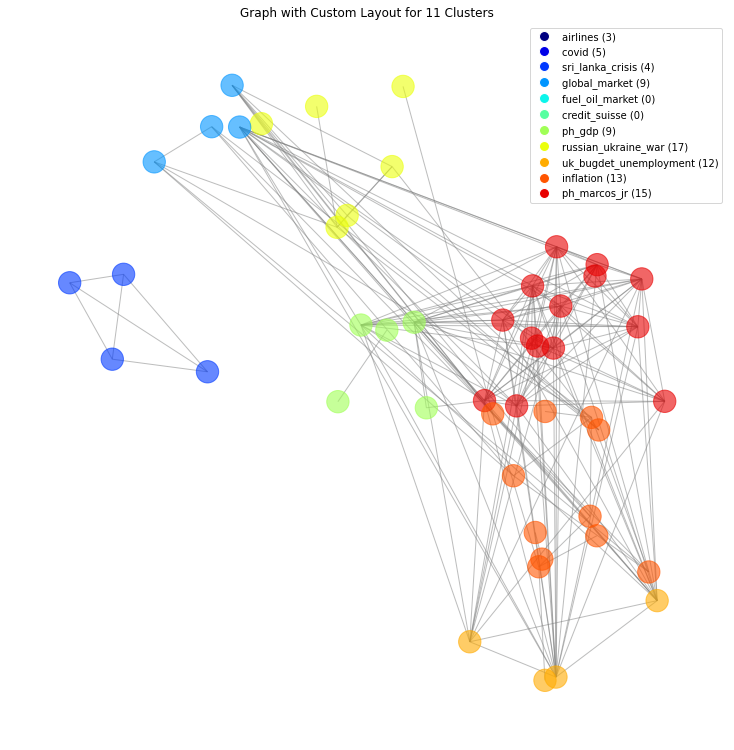

...

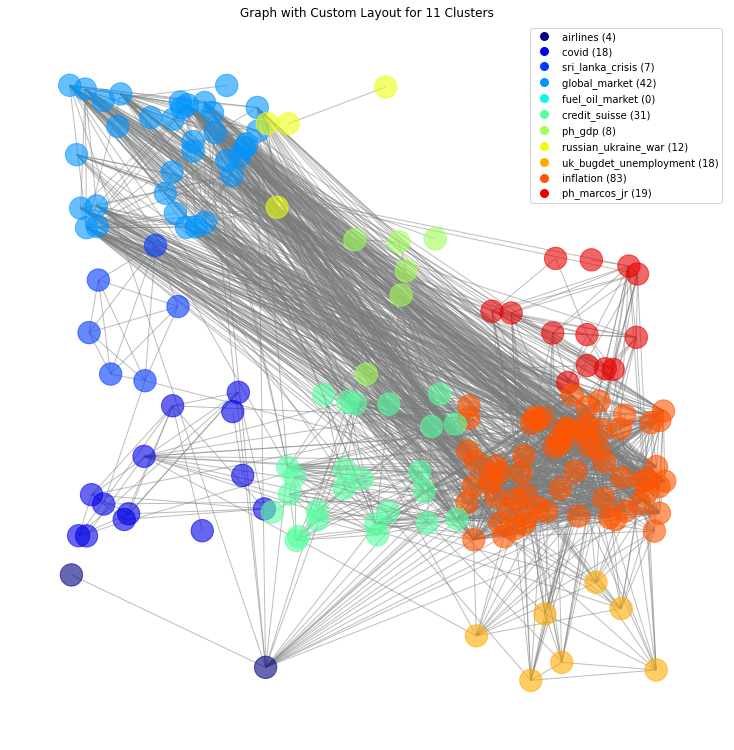

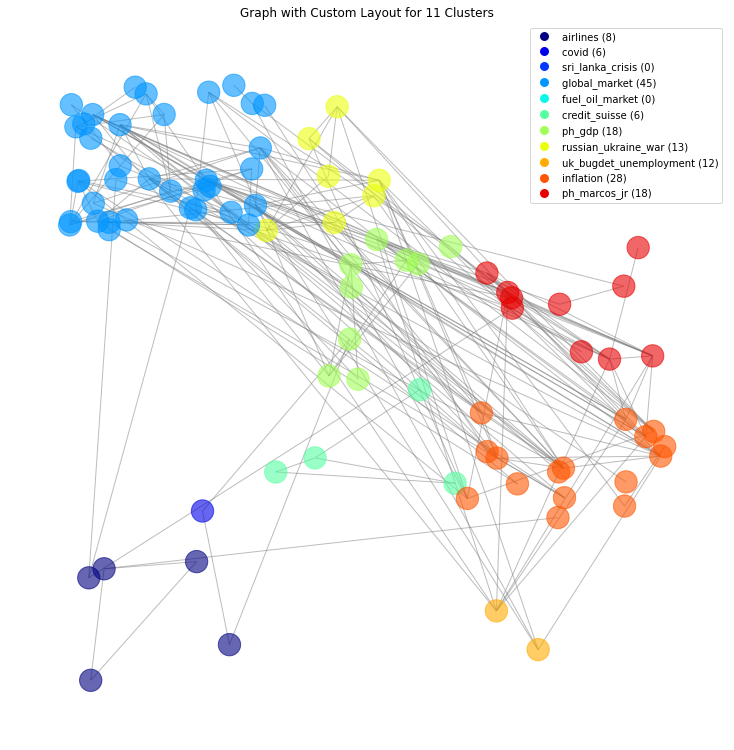

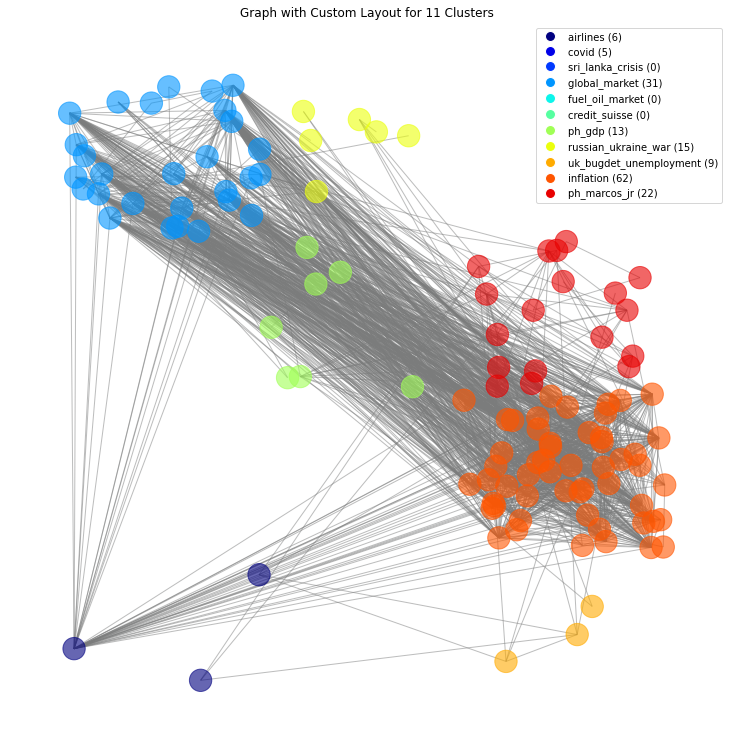

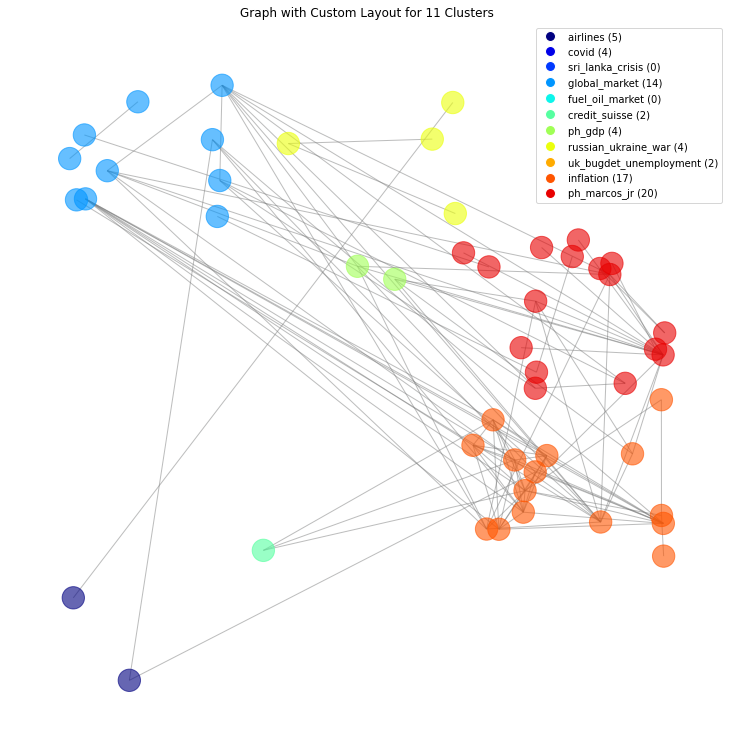

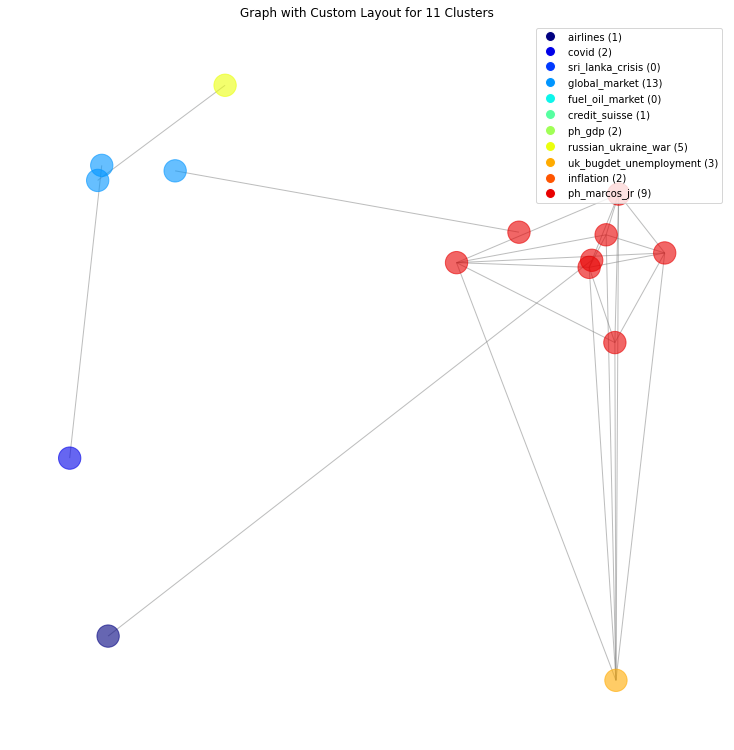

In [57]:
for i in df_final.month.unique():
    plot_network(m=i)

In [200]:
color_map

{'airlines': (0.0, 0.0, 0.5, 1.0),
 'credit_suisse': (0.0, 0.0, 0.909982174688057, 1.0),
 'uk_bugdet_unemployment': (0.0, 0.22156862745098038, 1.0, 1.0),
 'covid': (0.0, 0.5823529411764706, 1.0, 1.0),
 'ph_gdp': (0.04743833017077798, 0.9588235294117647, 0.920303605313093, 1.0),
 'russian_ukraine_war': (0.3383934218848829, 1.0, 0.629348513598988, 1.0),
 'ph_marcos_jr': (0.6293485135989879, 1.0, 0.338393421884883, 1.0),
 'global_market': (0.9203036053130929, 1.0, 0.04743833017077803, 1.0),
 'fuel_oil_market': (1.0, 0.6688453159041396, 0.0, 1.0),
 'sri_lanka_crisis': (1.0, 0.33478576615831535, 0.0, 1.0),
 'inflation': (0.9099821746880573, 0.0007262164124910431, 0.0, 1.0)}

In [15]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import calendar

def plot_network(m):
    m_map = {('0'+str(i) if len(str(i))==1 else str(i)):j for i, j in zip(range(1,13), list(calendar.month_name)[1:])}
    m_df = df_final[df_final.month == m]
    labels = pd.Series(df_final.topic.values,index=df_final.id).to_dict()

    # Create a complete list of all unique topics from the dataset
    all_topics = set(df_final.topic.unique())

    # Update topic_counts to include all topics
    topic_counts = {topic: 0 for topic in all_topics}
    for topic, count in m_df.topic.value_counts().items():
        topic_counts[topic] = count

    # Create a sample graph (replace this with your graph)
    article_projection = nx.bipartite.projected_graph(B, article_nodes)
    article_projection.remove_nodes_from(df_final[df_final.month != m].id.tolist())
    article_projection.remove_nodes_from(list(nx.isolates(article_projection)))

    pos = custom_layout(article_projection, labels)

    # Set node colors based on external cluster labels
    unique_labels = list(set(labels.values()))
    color_map = {label: plt.cm.jet(i/len(unique_labels)) for i, label in enumerate(unique_labels)}
    node_colors = [(*color_map[labels[node]][:3], 0.6) for node in article_projection.nodes()]
    print(color_map)

    # Create a figure with custom gridspec
    fig = plt.figure(figsize=(30, 15))
    gs = gridspec.GridSpec(1, 2, width_ratios=[2, 1])

    # Plot the network on the left side
    ax0 = plt.subplot(gs[0])
    nx.draw(article_projection, pos, node_color=node_colors, edge_color=(0.4823529411764706, 0.48627450980392156, 0.48627450980392156,0.5), node_size=500, ax=ax0)
    ax0.set_title(f"Changes in Article Topics Over Time ({m_map[m[-2:]]} {m[:4]})", fontsize=35)

    # Plot the horizontal bar chart on the right side
    ax1 = plt.subplot(gs[1])

    # Sort topics alphabetically
    sorted_topics = sorted(topic_counts.keys())
    sorted_counts = [topic_counts[topic] for topic in sorted_topics]

    ax1.barh([i.upper() for i in sorted_topics], sorted_counts, color=[color_map[topic] for topic in sorted_topics])
    ax1.set_title('Count of Articles per Topic Over Time', fontsize=30)
    ax1.set_xlim(0, 100)

    # Identify the topic with the highest count
    max_topic = max(topic_counts, key=topic_counts.get).upper()

    # Create a list of font weights
    font_weights = ['bold' if topic.upper() == max_topic else 'normal' for topic in sorted_topics]

    # Apply font weights to y-tick labels
    labels = [i.upper() for i in sorted_topics]
    ax1.set_yticks(range(len(labels)))
    y_tick_labels = ax1.set_yticklabels(labels)

    # Set individual font weights for each y-tick label
    for i, label in enumerate(y_tick_labels):
        label.set_fontweight(font_weights[i])

    ax1.invert_yaxis()

    # Remove the border of the bar plot
    for spine in ax1.spines.values():
        spine.set_visible(False)

    # Change the size of the y-axis ticks to 15
    ax1.tick_params(axis='y', labelsize=20)
    ax1.tick_params(axis='x', labelsize=20)

    plt.tight_layout()
    #plt.savefig(f'images/new/{m}.png', dpi=200)
    plt.show()



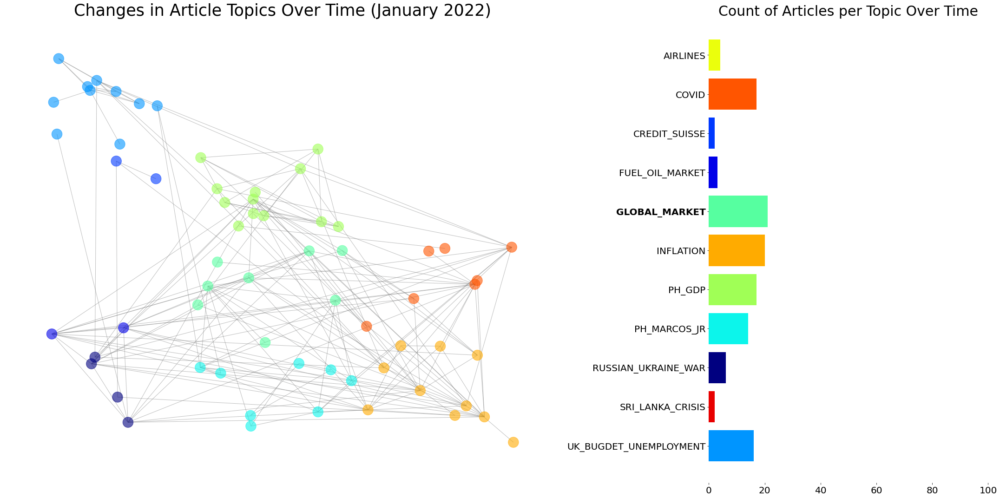

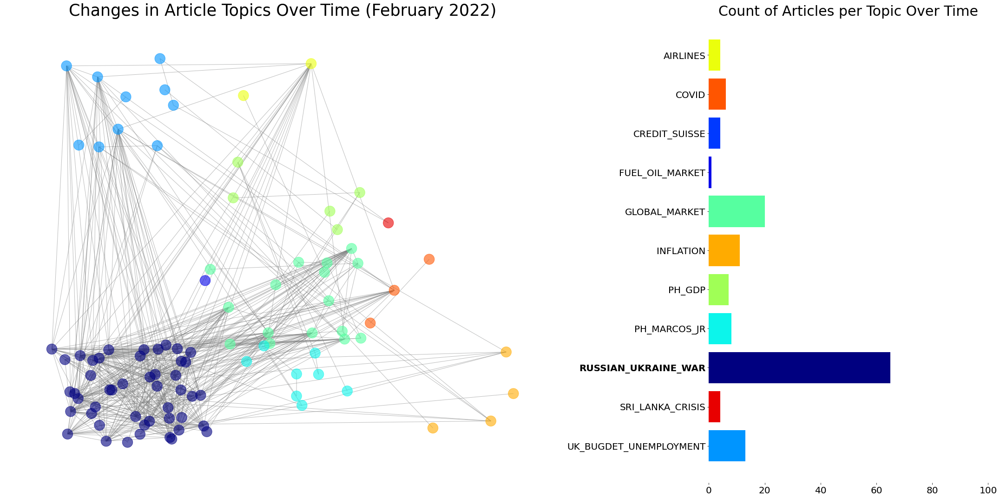

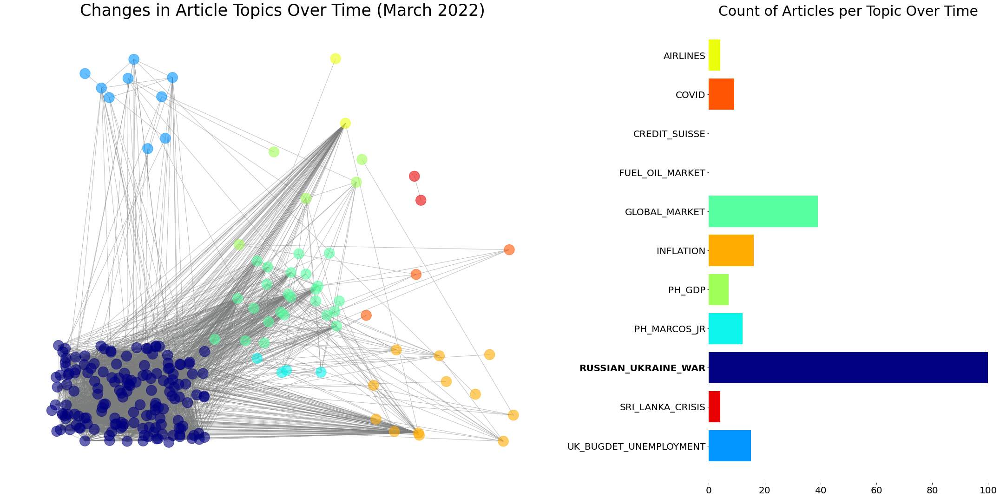

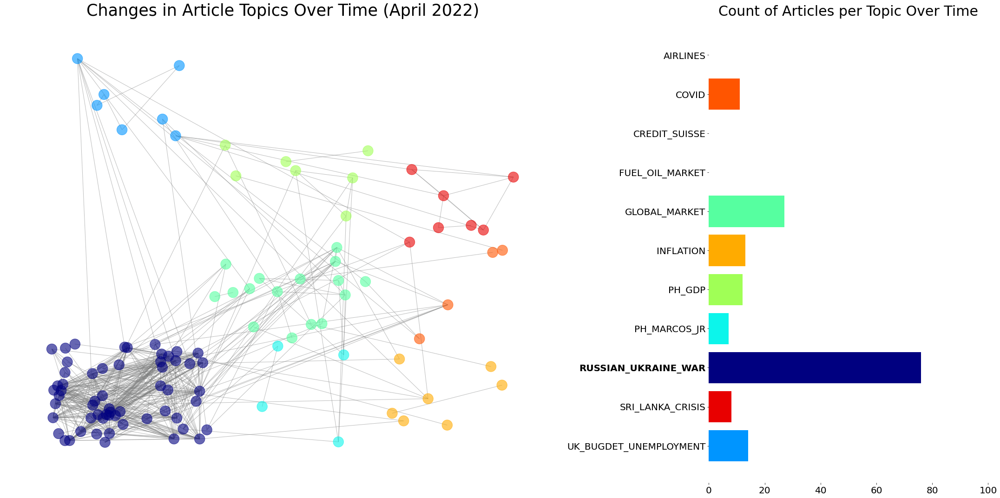

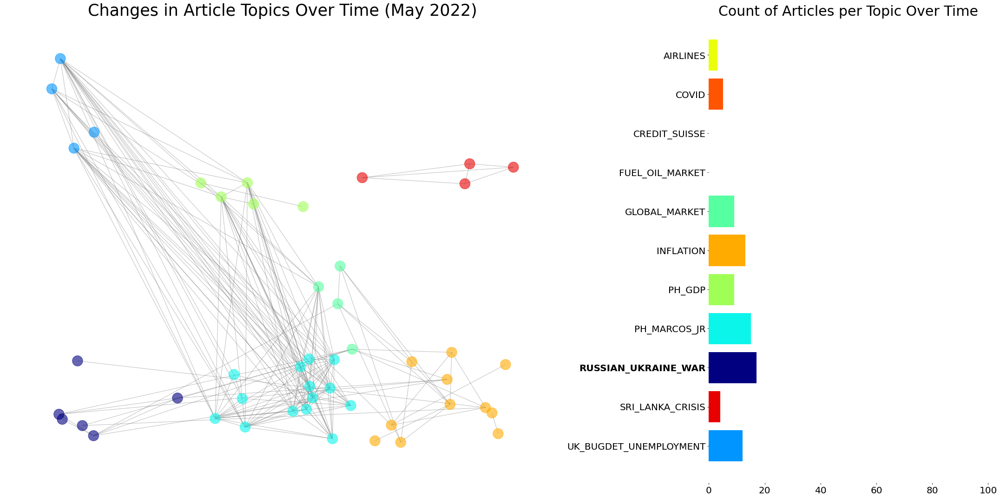

...

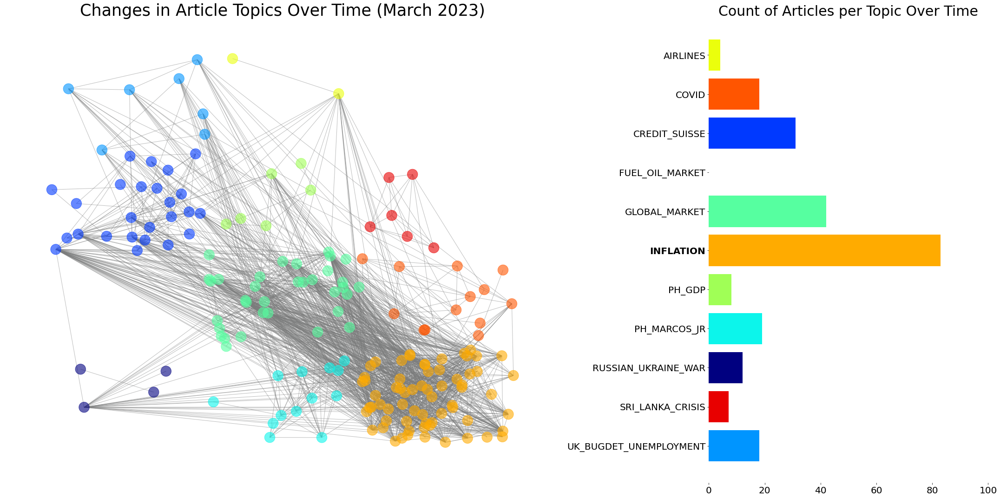

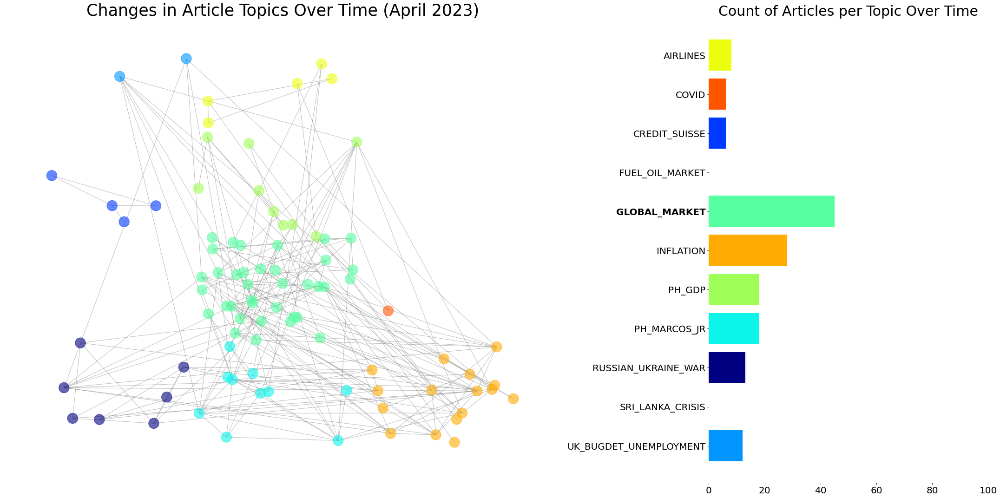

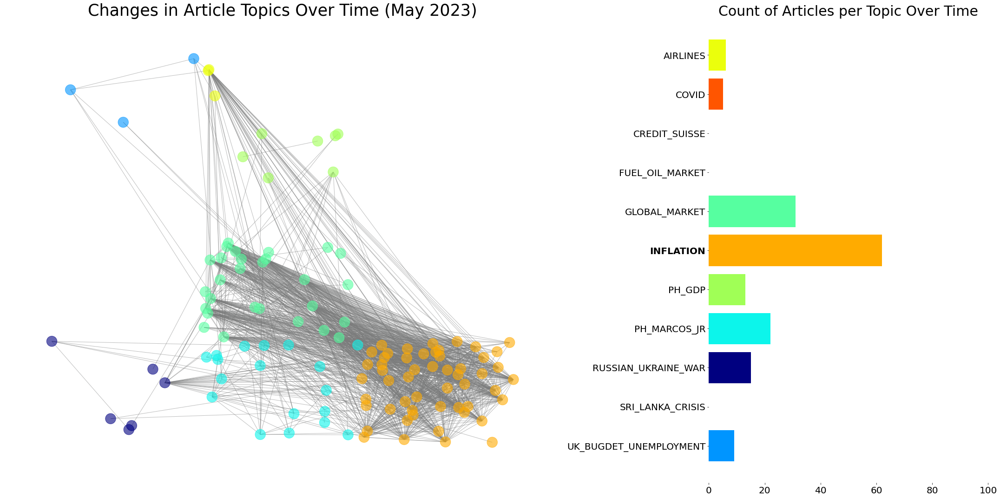

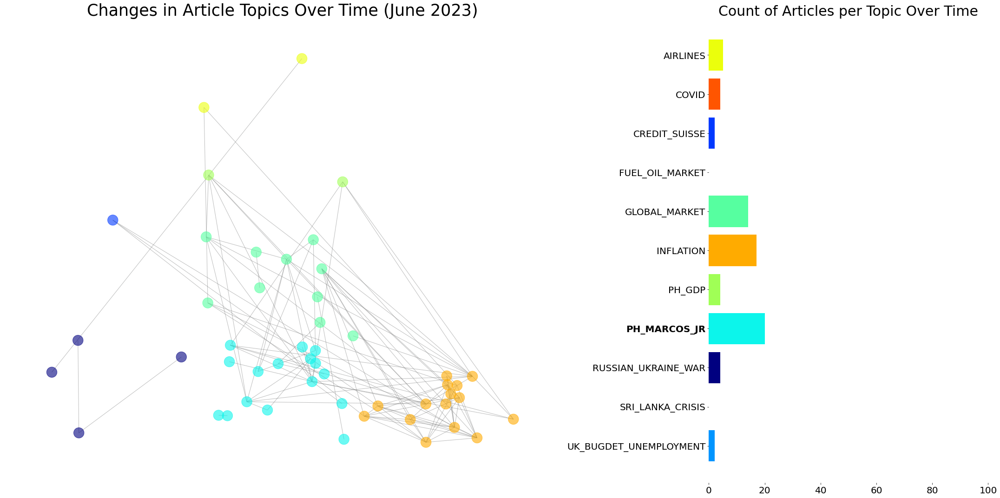

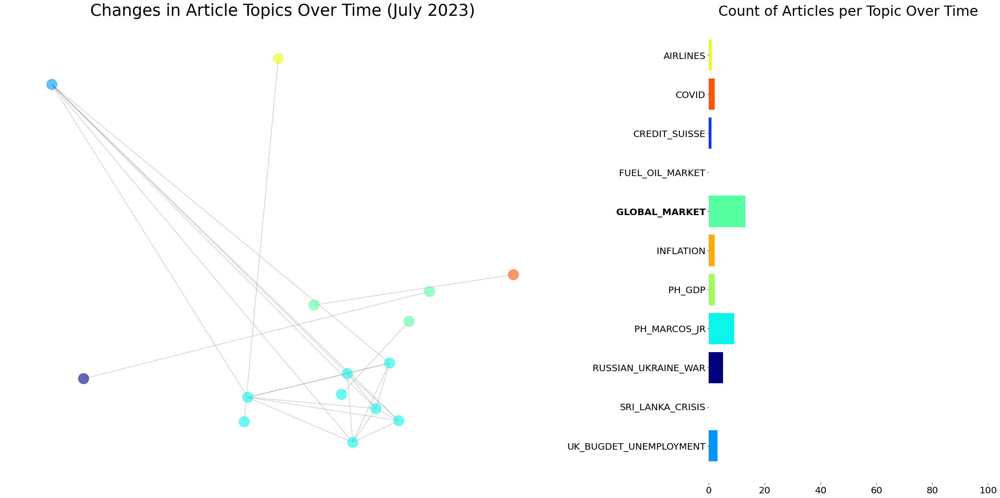

In [33]:
for i in df_final.month.unique():
    plot_network(m=i)

In [41]:
topic_counts = df_final.topic.value_counts().to_dict()
sorted(topic_counts.keys(), key=lambda x: topic_counts[x], reverse=True)

['russian_ukraine_war',
 'global_market',
 'inflation',
 'ph_marcos_jr',
 'uk_bugdet_unemployment',
 'ph_gdp',
 'covid',
 'airlines',
 'fuel_oil_market',
 'sri_lanka_crisis',
 'credit_suisse']

In [42]:
[i.upper() for i in sorted(topic_counts.keys(), key=lambda x: topic_counts[x], reverse=True)]

['RUSSIAN_UKRAINE_WAR',
 'GLOBAL_MARKET',
 'INFLATION',
 'PH_MARCOS_JR',
 'UK_BUGDET_UNEMPLOYMENT',
 'PH_GDP',
 'COVID',
 'AIRLINES',
 'FUEL_OIL_MARKET',
 'SRI_LANKA_CRISIS',
 'CREDIT_SUISSE']

{'inflation': (0.0, 0.0, 0.5, 1.0), 'covid': (0.0, 0.0, 0.909982174688057, 1.0), 'uk_bugdet_unemployment': (0.0, 0.22156862745098038, 1.0, 1.0), 'ph_gdp': (0.0, 0.5823529411764706, 1.0, 1.0), 'credit_suisse': (0.04743833017077798, 0.9588235294117647, 0.920303605313093, 1.0), 'russian_ukraine_war': (0.3383934218848829, 1.0, 0.629348513598988, 1.0), 'sri_lanka_crisis': (0.6293485135989879, 1.0, 0.338393421884883, 1.0), 'global_market': (0.9203036053130929, 1.0, 0.04743833017077803, 1.0), 'ph_marcos_jr': (1.0, 0.6688453159041396, 0.0, 1.0), 'airlines': (1.0, 0.33478576615831535, 0.0, 1.0), 'fuel_oil_market': (0.9099821746880573, 0.0007262164124910431, 0.0, 1.0)}


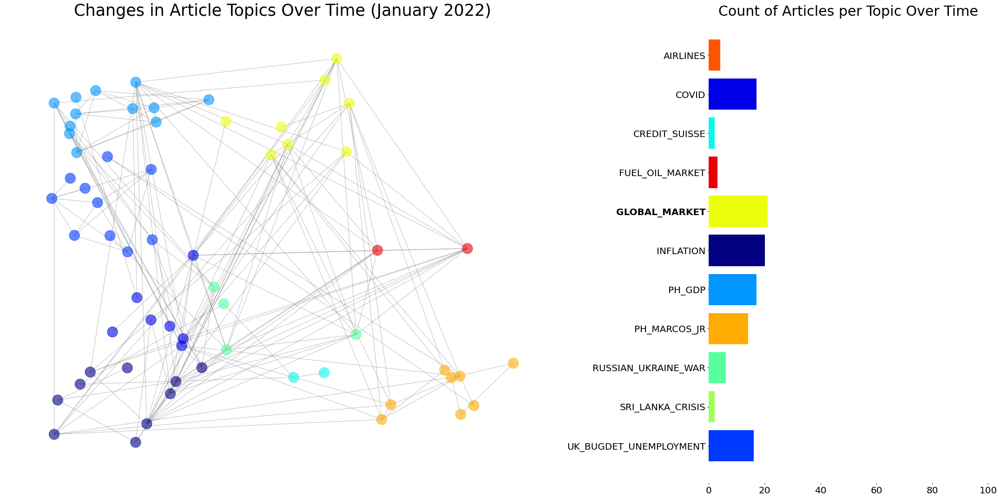

In [16]:
for i in df_final.month.unique()[:1]:
    plot_network(m=i)

In [ ]:
color_map = {'inflation': (0.0, 0.0, 0.5, 1.0), 
             'covid': (0.0, 0.0, 0.909982174688057, 1.0), 
             'uk_bugdet_unemployment': (0.0, 0.22156862745098038, 1.0, 1.0), 
             'ph_gdp': (0.0, 0.5823529411764706, 1.0, 1.0), 
             'credit_suisse': (0.04743833017077798, 0.9588235294117647, 0.920303605313093, 1.0), 
             'russian_ukraine_war': (0.3383934218848829, 1.0, 0.629348513598988, 1.0), 
             'sri_lanka_crisis': (0.6293485135989879, 1.0, 0.338393421884883, 1.0), 
             'global_market': (0.9203036053130929, 1.0, 0.04743833017077803, 1.0), 
             'ph_marcos_jr': (1.0, 0.6688453159041396, 0.0, 1.0), 
             'airlines': (1.0, 0.33478576615831535, 0.0, 1.0), 
             'fuel_oil_market': (0.9099821746880573, 0.0007262164124910431, 0.0, 1.0)}

In [52]:
color_map = {'inflation': (1.0, 0.6688453159041396, 0.0, 1.0), 
             'covid': (1.0, 0.33478576615831535, 0.0, 1.0), 
             'uk_bugdet_unemployment': (0.0, 0.5823529411764706, 1.0, 1.0), 
             'ph_gdp': (0.6293485135989879, 1.0, 0.338393421884883, 1.0), 
             'credit_suisse': (0.0, 0.22156862745098038, 1.0, 1.0), 
             'russian_ukraine_war': (0.0, 0.0, 0.5, 1.0), 
             'sri_lanka_crisis': (0.9099821746880573, 0.0007262164124910431, 0.0, 1.0), 
             'global_market': (0.3383934218848829, 1.0, 0.629348513598988, 1.0), 
             'ph_marcos_jr': (0.04743833017077798, 0.9588235294117647, 0.920303605313093, 1.0), 
             'airlines': (0.9203036053130929, 1.0, 0.04743833017077803, 1.0), 
             'fuel_oil_market': (0.5058823529411764, 0.5215686274509804, 0.5372549019607843, 1.0)}

In [49]:
# 1. Create a table for nodes (topic clusters)
_nodes = df_final['topic'].unique()

# 2. Create a table for edges (number of unique similar/shared entities)
_edges = []
for i in range(len(_nodes)):
    for j in range(i+1, len(_nodes)):
        topic1 = _nodes[i]
        topic2 = _nodes[j]
        
        # Get entities for each topic
#         entities_topic1 = df_final[df_final['topic'] == topic1]['unique_entities'].explode().unique()
#         entities_topic2 = df_final[df_final['topic'] == topic2]['unique_entities'].explode().unique()
        entities_topic1 = list(set([e for sublist in df_final[df_final['topic'] == topic1]['unique_entities'] for e in eval(sublist)]))
        entities_topic2 = list(set([e for sublist in df_final[df_final['topic'] == topic2]['unique_entities'] for e in eval(sublist)]))
        
        # Find common entities
        common_entities = len(set(entities_topic1).intersection(entities_topic2))
        
        if common_entities > 0:
            _edges.append((topic1, topic2, common_entities))

# Convert edges list to DataFrame
edges_df = pd.DataFrame(_edges, columns=['topic1', 'topic2', 'shared_entities_count'])

print("Nodes:")
print(_nodes)
print("\nEdges:")
print(edges_df)


Nodes:
['russian_ukraine_war' 'inflation' 'uk_bugdet_unemployment' 'covid'
 'global_market' 'airlines' 'sri_lanka_crisis' 'ph_marcos_jr'
 'fuel_oil_market' 'ph_gdp' 'credit_suisse']

Edges:
                    topic1                  topic2  shared_entities_count
0      russian_ukraine_war               inflation                    122
1      russian_ukraine_war  uk_bugdet_unemployment                     64
2      russian_ukraine_war                   covid                     38
3      russian_ukraine_war           global_market                    102
4      russian_ukraine_war                airlines                     43
5      russian_ukraine_war        sri_lanka_crisis                      9
6      russian_ukraine_war            ph_marcos_jr                     24
7      russian_ukraine_war         fuel_oil_market                     26
8      russian_ukraine_war                  ph_gdp                     50
9      russian_ukraine_war           credit_suisse                    

In [50]:
edges_df

,topic1,topic2,shared_entities_count
0,russian_ukraine_war,inflation,122
1,russian_ukraine_war,uk_bugdet_unemployment,64
2,russian_ukraine_war,covid,38
3,russian_ukraine_war,global_market,102
4,russian_ukraine_war,airlines,43
5,russian_ukraine_war,sri_lanka_crisis,9
6,russian_ukraine_war,ph_marcos_jr,24
7,russian_ukraine_war,fuel_oil_market,26
8,russian_ukraine_war,ph_gdp,50
9,russian_ukraine_war,credit_suisse,16


C:\Users\Ching\AppData\Local\Temp\ipykernel_35416\1171239884.py:38: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


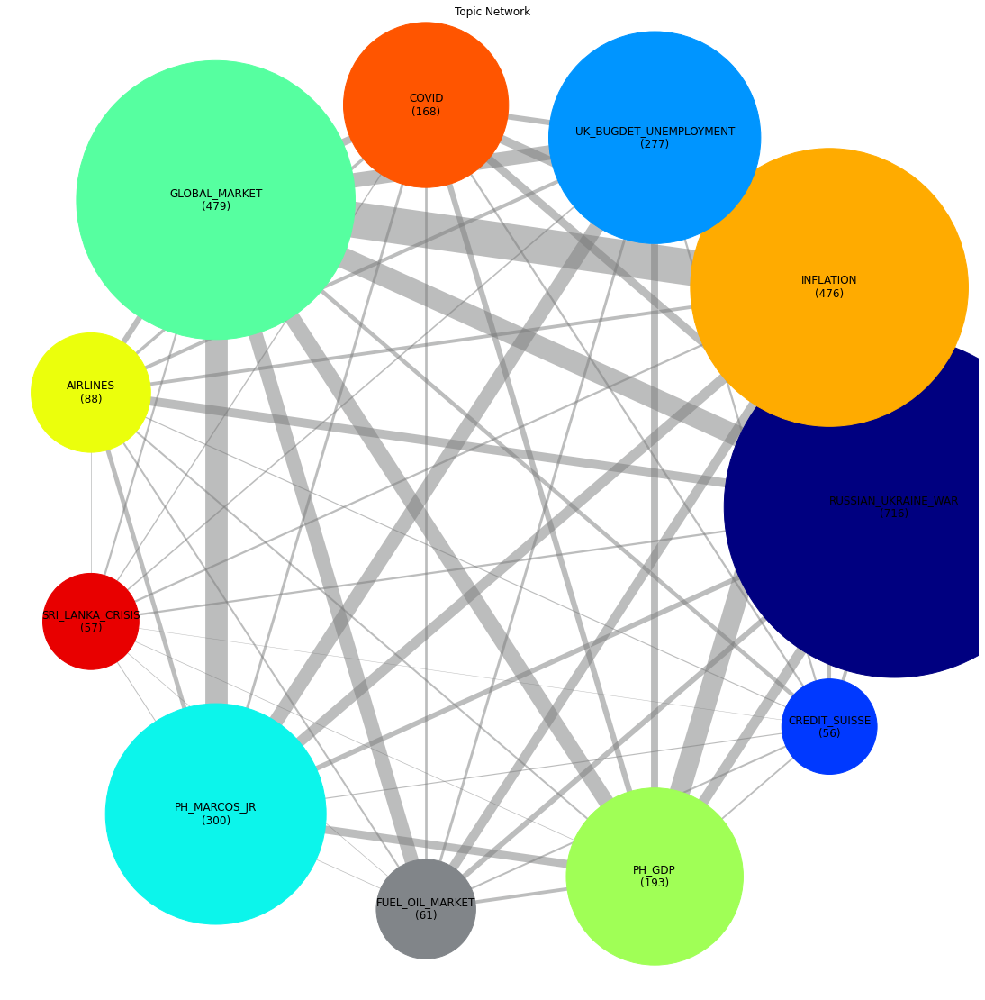

In [82]:
import networkx as nx
import matplotlib.pyplot as plt

# 1. Create a graph object
G = nx.Graph()

# 2. Add nodes and edges to the graph
G.add_nodes_from(_nodes)
G.add_weighted_edges_from(_edges)

# 3. Define node colors, edge weights, and node sizes
node_colors = [color_map[node] for node in G.nodes()]
edge_weights = [G[u][v]['weight'] for u, v in G.edges()]
node_sizes = [df_final[df_final['topic'] == node].shape[0] * 200 for node in G.nodes()]  # Multiplied by 100 for better visualization

# Determine the minimum and maximum edge weights
min_weight = min(edge_weights)
max_weight = max(edge_weights)

# Define the desired range for the scaled weights
min_scale = 0.5
max_scale = 40

# Apply the Min-Max scaling formula
scaled_weights = [(w - min_weight) / (max_weight - min_weight) * (max_scale - min_scale) + min_scale for w in edge_weights]

# Modify node labels to include article count
labels = {}
for node in G.nodes():
    article_count = df_final[df_final['topic'] == node].shape[0]
    labels[node] = f"{node.upper()}\n({article_count})"

# 4. Draw the graph
plt.figure(figsize=(15,15))
pos = nx.circular_layout(G)
nx.draw(G, pos, with_labels=True, labels=labels, node_color=node_colors, edge_color=(0.4823529411764706, 0.48627450980392156, 0.48627450980392156,0.5), width=scaled_weights, node_size=node_sizes, font_size=12)
plt.title("Topic Network")
plt.tight_layout()
#plt.savefig(f'images/new/new.png', dpi=200, bbox_inches='tight')
plt.show()


In [83]:
edges_df

,topic1,topic2,shared_entities_count
0,russian_ukraine_war,inflation,122
1,russian_ukraine_war,uk_bugdet_unemployment,64
2,russian_ukraine_war,covid,38
3,russian_ukraine_war,global_market,102
4,russian_ukraine_war,airlines,43
5,russian_ukraine_war,sri_lanka_crisis,9
6,russian_ukraine_war,ph_marcos_jr,24
7,russian_ukraine_war,fuel_oil_market,26
8,russian_ukraine_war,ph_gdp,50
9,russian_ukraine_war,credit_suisse,16
